In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium import plugins
import json
sns.set()

In [2]:
import matplotlib
from matplotlib import font_manager, rc
import platform
if platform.system()=="Windows":
    font_name=font_manager.FontProperties(fname="malgun.ttf").get_name()
    rc('font', family=font_name)
matplotlib.rcParams['axes.unicode_minus']=False

import warnings
warnings.filterwarnings("ignore")

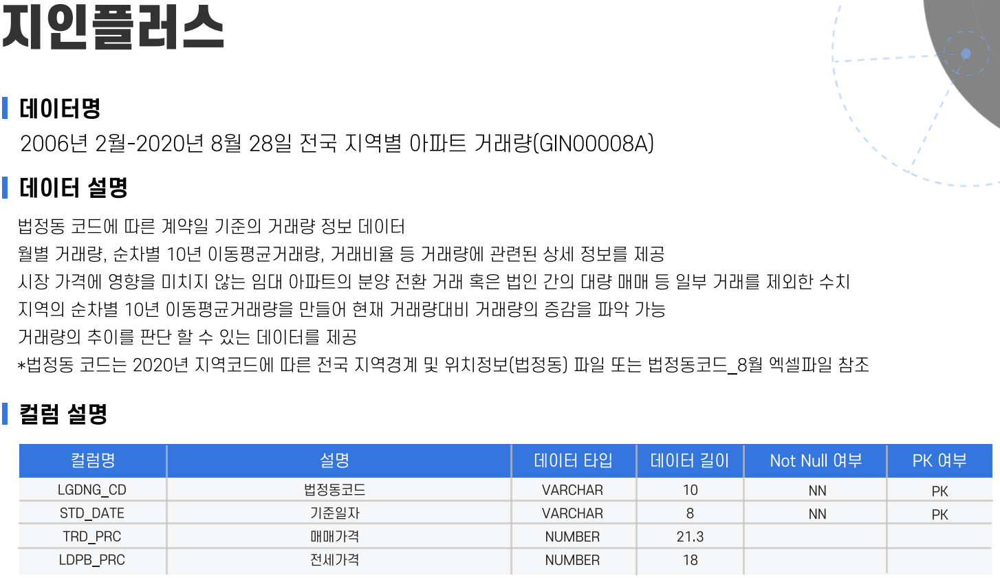

In [3]:
apt_amountdiet={'lgdng_cd':'법정동코드','std_date':'기준일자','trd_prc':'매매가격','ldpb_prc':'전세가격'}
apt_amount = pd.read_csv("./sample/GIN00009A.csv",parse_dates=['std_date'])
apt_amount=apt_amount.rename(columns=apt_amountdiet)

In [4]:
#날짜 수정
apt_amount['년']=apt_amount['기준일자'].dt.year
apt_amount['월']=apt_amount['기준일자'].dt.month
apt_amount['일']=apt_amount['기준일자'].dt.day
apt_amount=apt_amount.drop(['기준일자'],axis=1)

In [5]:
apt_amount=apt_amount[apt_amount['일']==21] #기준일은 21일로 정함
apt_amount=apt_amount.drop(['일'],axis=1)

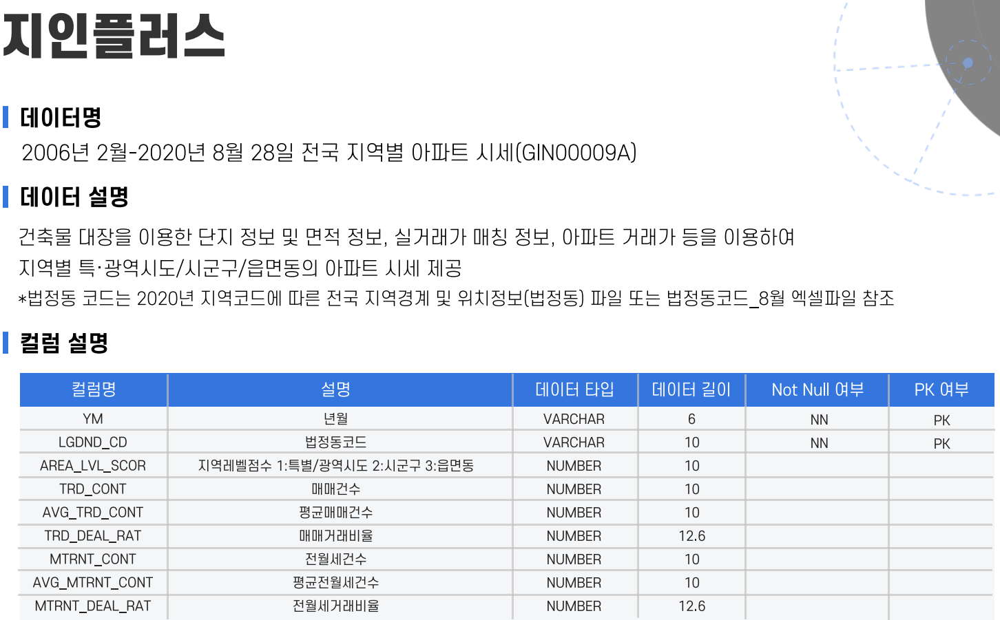

In [6]:
apt_pricediet={'ym':'년월','area_lvl_scor':'지역레벨점수','lgdng_cd':'법정동코드','trd_cont':'매매건수','avg_trd_cont':'평균매매건수','trd_deal_rat':'매매거래비율','mtrnt_cont':'전월세건수','avg_mtrnt_cont':'평균전월세건수','mtrnt_deal_rat':'전월세거래비율'}
apt_price = pd.read_csv("./sample/GIN00008A.csv",parse_dates=['ym'])
apt_price=apt_price.rename(columns=apt_pricediet)

In [7]:
# area_lvl_scor 지역점수 [1,2,3]으로 되어 있다 0은 제외
print(apt_price['지역레벨점수'].unique())
apt_price=apt_price[apt_price['지역레벨점수']!=0]

[0 1 2 3]


In [8]:
#날짜 수정
apt_price['년']=apt_price['년월'].apply(lambda x : int(x[0:4]) )
apt_price['월']=apt_price['년월'].apply(lambda x : int(x[4:6]) )

In [9]:
apts=apt_amount.merge(apt_price)

In [10]:
apts['법정동코드']=apts['법정동코드'].astype('category')
apts['지역레벨점수']=apts['지역레벨점수'].astype('category')

# 아파트 관련 데이터 분석
## 부동산 정책
### 2017년
>* 6.19 / 주택시장의 안정적 관리를 위한 선별적·맞춤형 대응방안
* 8.2 / 실수요 보호와 단기 투기수요 억제를 통한 주택시장 안정화 방안
* 9.5 / 8.2 대책 후속조치
* 10.24 / 가계부채 종합대책
* 11.29 / 주거복지로드맵
* 12.13 / 임대주택 등록 활성화 방안

### 2018년
>* 6.28 / 2018년 주거종합계획*, 제2차 장기 주거종합계획(2013~2022) 수정계획
* 7.5 / 신혼부부·청년 주거지원 방안
* 8.27 / 수도권 주택공급 확대 추진 및 투기지역 지정 등을 통한 시장안정 기조 강화
* 9.13 / 주택시장 안정대책
* 9.21 / 수도권 주택공급 확대방안
* 12.19 / 2차 수도권 주택공급 계획 및 수도권 광역교통망 개선방안

### 2019년
>* 1.9 / 등록 임대주택 관리 강화방안
* 4.23 / 2019년 주거종합계획*
* 5.7 / 제3차 신규택지 추진계획
* 8.12 / 민간택지 분양가상한제 적용기준 개선 추진
* 10.1 / 부동산 시장 점검 결과 및 보완방안 (시장안정대책, 분양가상한제 시행령 개정안 보완방안)
* 11.6 / 민간택지 분양가상한제 지정
* 12.16 / 주택시장 안정화 방안

### 2020년
>* 2.20 / 투기 수요 차단을 통한 주택시장 안정적 관리 기조 강화
* 5.6 / 수도권 주택공급 기반 강화 방안
* 5.20 / 2020년 주거종합계획*
* 6.17 / 주택시장 안정을 위한 관리방안
* 7.10 / 주택시장 안정 보완대책
* 8.4 / 서울권역 등 수도권 주택공급 확대방안

## 코로나 발생일
> 202002 ~ 202008

## 미세먼지 발생일
> 201712 ~ 201803, 201812 ~ 201903, 201912 ~ 202003 

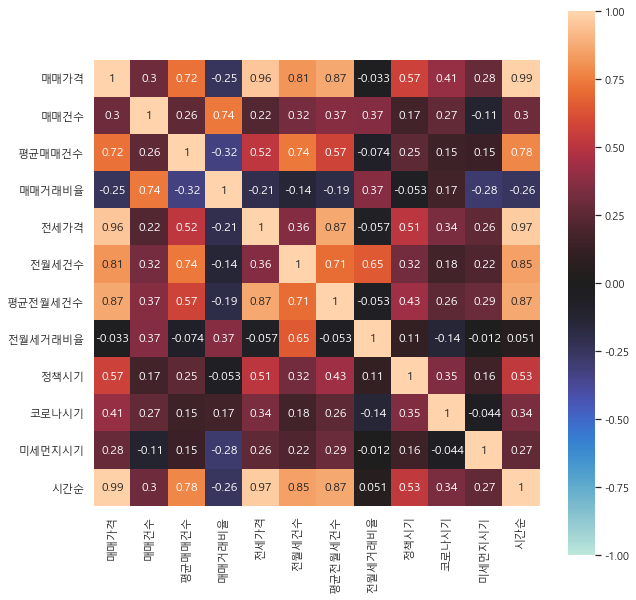

In [11]:
ym=[201706,201708,201709,201710,201711,201712,201806,201807,201808,201809,201812,201901,201904,201905,201908,201910,201911,201912,202002,202005,202006,202007,202008]
cm=[202002,202003,202004,202005,202006,202007,202008]
mm=[201712,201801,201802,201803,201812,201901,201902,201903]
apts['정책시기']=False
apts['정책시기'][apts['년월'].astype('int64').isin(ym)]=True
apts['코로나시기']=False
apts['코로나시기'][apts['년월'].astype('int64').isin(cm)]=True
apts['미세먼지시기']=False
apts['미세먼지시기'][apts['년월'].astype('int64').isin(mm)]=True
apts_1=apts[apts['지역레벨점수']==1]
apts_yd=apts_1.groupby(['년월'])[['매매가격','매매건수','평균매매건수','매매거래비율','전세가격','전월세건수','평균전월세건수','전월세거래비율','정책시기','코로나시기','미세먼지시기']].mean()
apts_yd
apts_yd['시간순']=np.arange(176)
apt_corr=apts_yd.corr()
apt_corr
plt.figure(figsize=(10,10))
sns.heatmap(apt_corr,vmin=-1,vmax=1,center=0,annot=True,square=True)

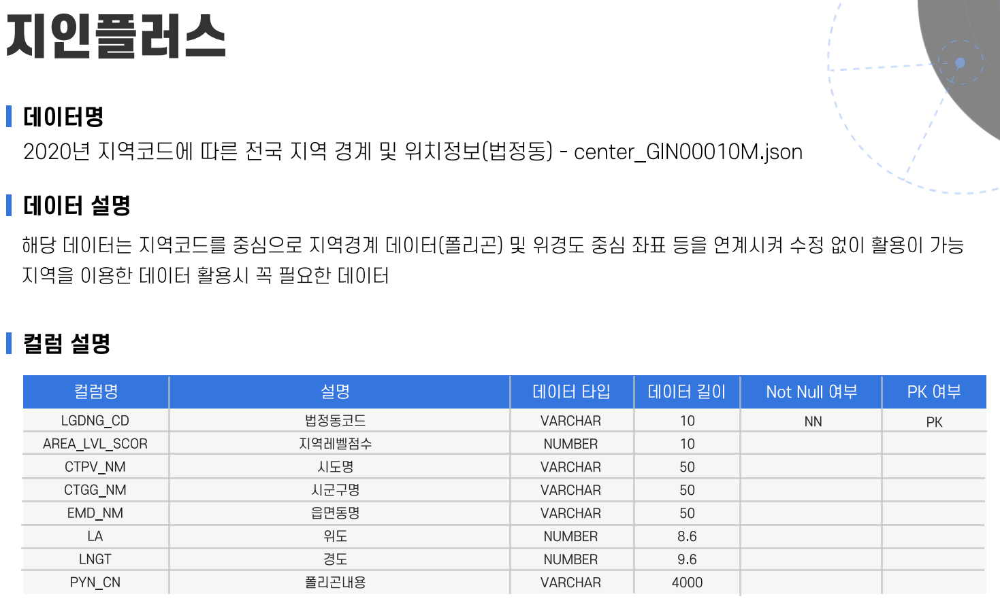

In [12]:
regiondiet={'AREA_LVL_SCOR':'지역레벨점수','LGDNG_CD':'법정동코드','CTPV_NM':'시도명','CTGG_NM':'시군구명','EMD_NM':'읍면동명','LA':'위도','LNGT':'경도','PYN_CN':'폴리곤내용'}
region = pd.read_json("./sample/center_GIN00010M.json")
region=region.rename(columns=regiondiet)

In [13]:
# reg = pd.read_json("./sample/center_GIN00010M.json")
# reg=reg[(reg['AREA_LVL_SCOR']==2) & ((reg['CTPV_NM']=='경기도') | (reg['CTPV_NM']=='서울특별시'))]
# temp=[]
# for i in reg.index:
#     features={}
#     features["type"]="Feature"
#     features["properties"]={"AREA_LVL_SCOR":reg["AREA_LVL_SCOR"][i],"LGDNG_CD":reg["LGDNG_CD"][i],"CTPV_NM":reg["CTPV_NM"][i],"CTGG_NM":reg["CTGG_NM"][i],"EMD_NM":reg["EMD_NM"][i],"LA":reg["LA"][i],"LNGT":reg["LNGT"][i]}
#     features["geometry"]=eval(reg["PYN_CN"][i])
#     temp.append(features)
# geo_data={
# "type": "FeatureCollection",
# "crs": { "type": "name", "properties": { "name": "urn:ogc:def:crs:OGC:1.3:CRS84" } },
# "features":temp}
# geo_data
# f=open('geo_data.txt','w')
# f.write(str(geo_data))
# f.close()

In [14]:
apts=apts.merge(region)

In [15]:
apts['전월세건수'][apts['전세가격'].isnull()]=np.nan
apts['평균전월세건수'][apts['전월세거래비율'].isnull()]=np.nan

In [16]:
apts['년월']=apts['년월'].astype('int64')
apts=apts[apts['년월']>201812]

In [17]:
a1=apts[apts['지역레벨점수']==1]
pd.pivot_table(a1 , index=('년월','시군구명') , values=('매매가격','매매건수','매매거래비율','평균매매건수','전세가격','전월세건수','평균전월세건수','전월세거래비율'))

,
년월,시군구명


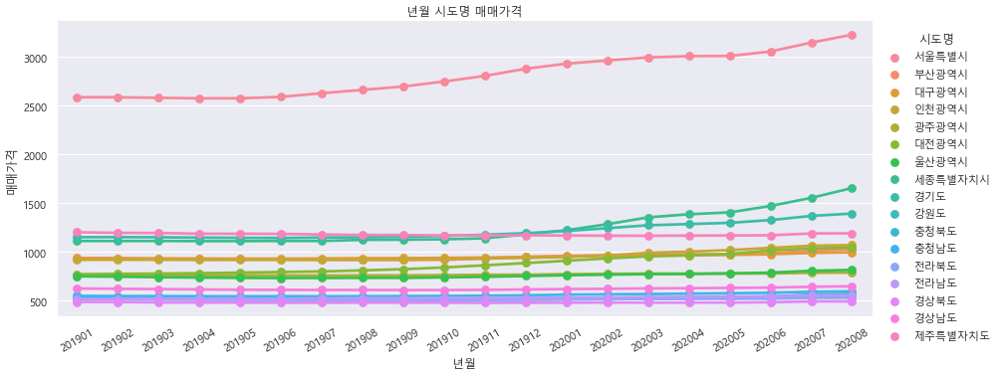

In [18]:
sns.factorplot(x='년월',y='매매가격',hue='시도명',aspect=2.5,data=a1)
plt.xticks(rotation=30)
plt.title('년월 시도명 매매가격')
plt.show()

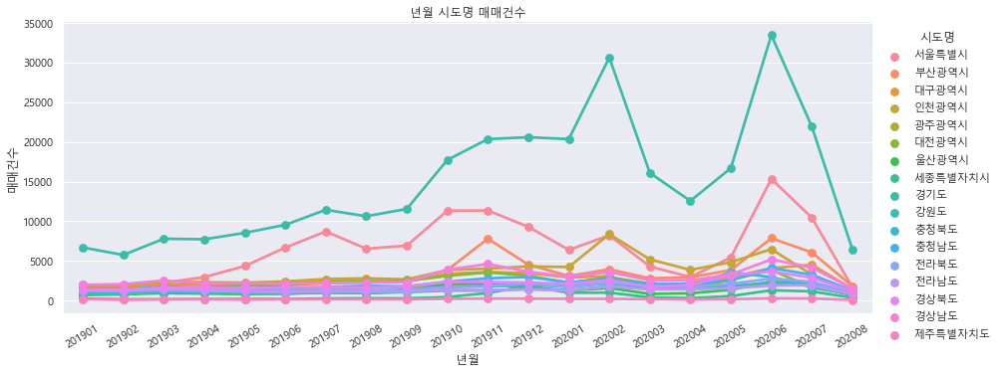

In [19]:
sns.factorplot(x='년월',y='매매건수',hue='시도명',aspect=2.5,data=a1)
plt.xticks(rotation=30)
plt.title('년월 시도명 매매건수')
plt.show()

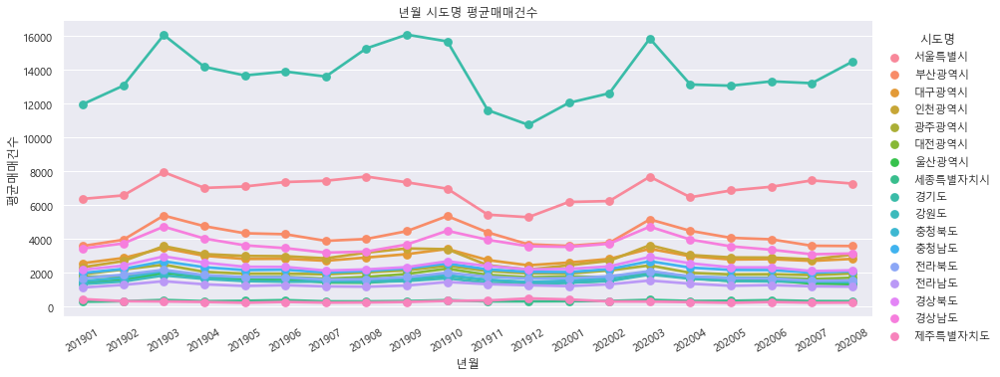

In [20]:
sns.factorplot(x='년월',y='평균매매건수',hue='시도명',aspect=2.5,data=a1)
plt.xticks(rotation=30)
plt.title('년월 시도명 평균매매건수')
plt.show()

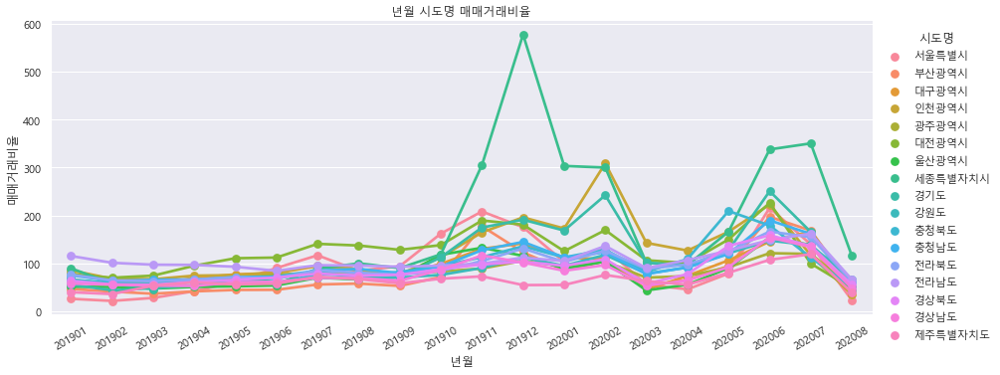

In [21]:
sns.factorplot(x='년월',y='매매거래비율',hue='시도명',aspect=2.5,data=a1)
plt.xticks(rotation=30)
plt.title('년월 시도명 매매거래비율')
plt.show()

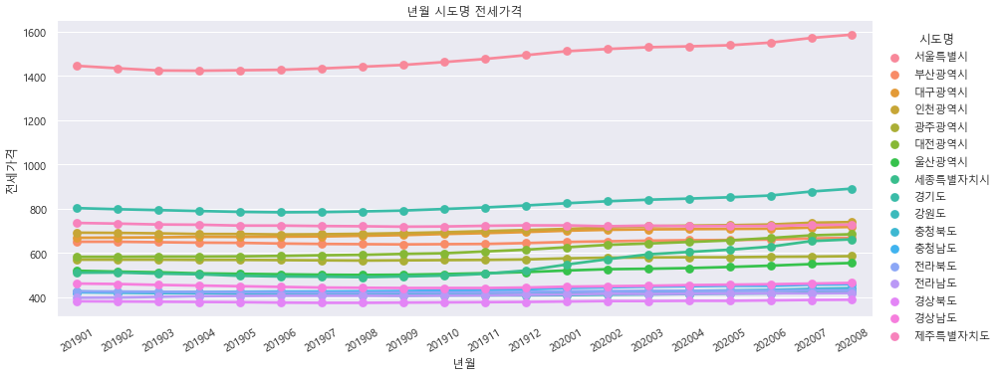

In [22]:
sns.factorplot(x='년월',y='전세가격',hue='시도명',aspect=2.5,data=a1)
plt.xticks(rotation=30)
plt.title('년월 시도명 전세가격')
plt.show()

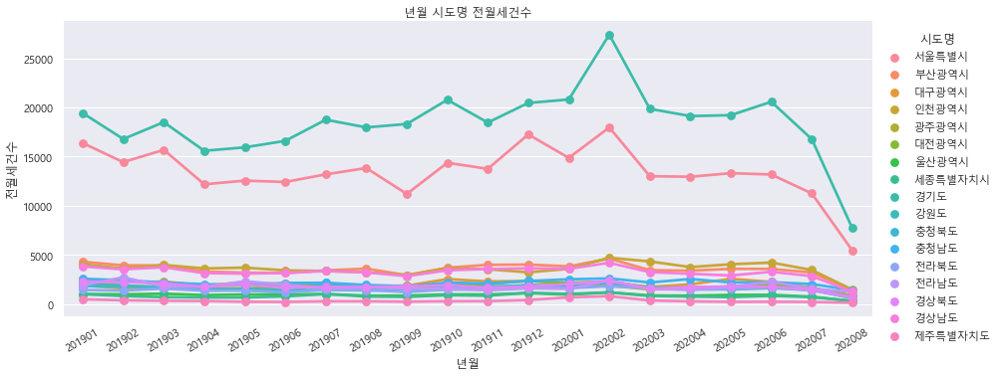

In [23]:
sns.factorplot(x='년월',y='전월세건수',hue='시도명',aspect=2.5,data=a1)
plt.xticks(rotation=30)
plt.title('년월 시도명 전월세건수')
plt.show()

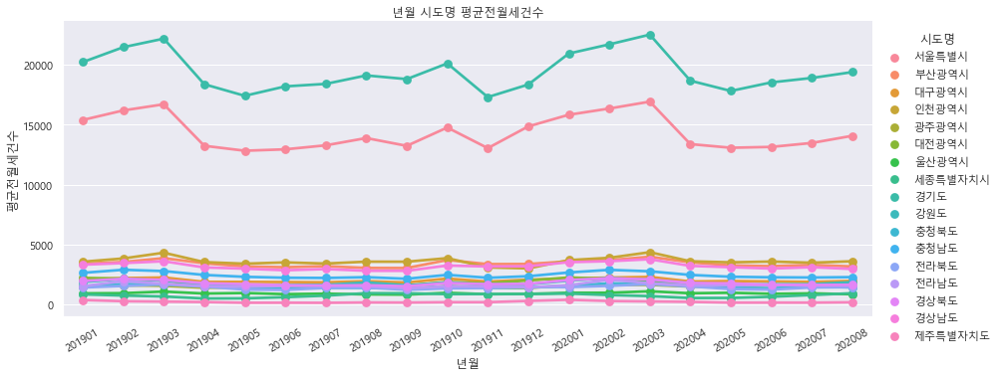

In [24]:
sns.factorplot(x='년월',y='평균전월세건수',hue='시도명',aspect=2.5,data=a1)
plt.xticks(rotation=30)
plt.title('년월 시도명 평균전월세건수')
plt.show()

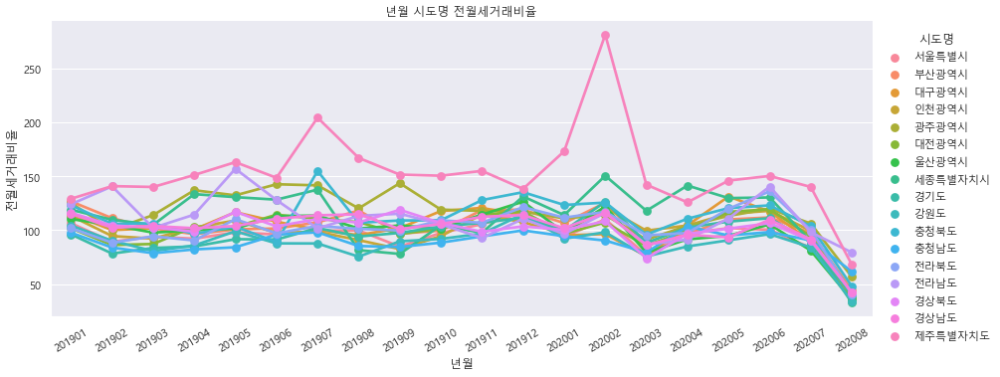

In [25]:
sns.factorplot(x='년월',y='전월세거래비율',hue='시도명',aspect=2.5,data=a1)
plt.xticks(rotation=30)
plt.title('년월 시도명 전월세거래비율')
plt.show()

In [26]:
mylist=['매매가격','매매건수','매매거래비율','평균매매건수','전세가격','전월세건수','평균전월세건수','전월세거래비율']
for i in mylist:
    a1[i+'scale']=(a1[i]-a1[i].min())/(a1[i].max()-a1[i].min())

In [27]:
a1_202002=a1[a1['년월']==202002]
a1_201902=a1[a1['년월']==201902]

In [28]:
label1=[]
for i in a1_201902.index:
    temp = a1_201902.loc[i,'시도명'] +' 매매가격 : '+ str(a1_201902.loc[i,'매매가격'])
    label1.append(temp)
label2=[]
for i in a1_202002.index:
    temp = a1_202002.loc[i,'시도명'] +' 매매가격 : '+ str(a1_202002.loc[i,'매매가격'])
    label2.append(temp)
    
center = [35.9, 127.986]
m = folium.plugins.DualMap(location=center,zoom_start=7,zoom_control=False)
folium.Choropleth( geo_data='CTPV.geojson',data=a1_201902,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '매매가격scale'),
                  fill_color='OrRd', legend_name='매매가격 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a1_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTPV.geojson',data=a1_202002,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '매매가격scale'),
                  fill_color='OrRd', legend_name='매매가격 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a1_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 대한민국 비교 매매가격.html")
m

In [29]:
label1=[]
for i in a1_201902.index:
    temp = a1_201902.loc[i,'시도명'] +' 매매건수 : '+ str(a1_201902.loc[i,'매매건수'])
    label1.append(temp)
label2=[]
for i in a1_202002.index:
    temp = a1_202002.loc[i,'시도명'] +' 매매건수 : '+ str(a1_202002.loc[i,'매매건수'])
    label2.append(temp)
    
center = [35.9, 127.986]
m = folium.plugins.DualMap(location=center,zoom_start=7,zoom_control=False)
folium.Choropleth( geo_data='CTPV.geojson',data=a1_201902,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '매매건수scale'),
                  fill_color='OrRd', legend_name='매매건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a1_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTPV.geojson',data=a1_202002,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '매매건수scale'),
                  fill_color='OrRd', legend_name='매매건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a1_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 대한민국 비교 매매건수.html")
m

In [30]:
label1=[]
for i in a1_201902.index:
    temp = a1_201902.loc[i,'시도명'] +' 평균매매건수 : '+ str(a1_201902.loc[i,'평균매매건수'])
    label1.append(temp)
label2=[]
for i in a1_202002.index:
    temp = a1_202002.loc[i,'시도명'] +' 평균매매건수 : '+ str(a1_202002.loc[i,'평균매매건수'])
    label2.append(temp)
    
center = [35.9, 127.986]
m = folium.plugins.DualMap(location=center,zoom_start=7,zoom_control=False)
folium.Choropleth( geo_data='CTPV.geojson',data=a1_201902,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '평균매매건수scale'),
                  fill_color='OrRd', legend_name='평균매매건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a1_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTPV.geojson',data=a1_202002,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '평균매매건수scale'),
                  fill_color='OrRd', legend_name='평균매매건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a1_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 대한민국 비교 평균매매건수.html")
m

In [31]:
label1=[]
for i in a1_201902.index:
    temp = a1_201902.loc[i,'시도명'] +' 매매거래비율 : '+ str(a1_201902.loc[i,'매매거래비율'])
    label1.append(temp)
label2=[]
for i in a1_202002.index:
    temp = a1_202002.loc[i,'시도명'] +' 매매거래비율 : '+ str(a1_202002.loc[i,'매매거래비율'])
    label2.append(temp)
    
center = [35.9, 127.986]
m = folium.plugins.DualMap(location=center,zoom_start=7,zoom_control=False)
folium.Choropleth( geo_data='CTPV.geojson',data=a1_201902,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '매매거래비율scale'),
                  fill_color='OrRd', legend_name='매매거래비율 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a1_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTPV.geojson',data=a1_202002,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '매매거래비율scale'),
                  fill_color='OrRd', legend_name='매매거래비율 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a1_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 대한민국 비교 매매거래비율.html")
m

In [32]:
label1=[]
for i in a1_201902.index:
    temp = a1_201902.loc[i,'시도명'] +' 전세가격 : '+ str(a1_201902.loc[i,'전세가격'])
    label1.append(temp)
label2=[]
for i in a1_202002.index:
    temp = a1_202002.loc[i,'시도명'] +' 전세가격 : '+ str(a1_202002.loc[i,'전세가격'])
    label2.append(temp)
    
center = [35.9, 127.986]
m = folium.plugins.DualMap(location=center,zoom_start=7,zoom_control=False)
folium.Choropleth( geo_data='CTPV.geojson',data=a1_201902,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '전세가격scale'),
                  fill_color='OrRd', legend_name='전세가격 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a1_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTPV.geojson',data=a1_202002,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '전세가격scale'),
                  fill_color='OrRd', legend_name='전세가격 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a1_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 대한민국 비교 전세가격.html")
m

In [33]:
label1=[]
for i in a1_201902.index:
    temp = a1_201902.loc[i,'시도명'] +' 전월세건수 : '+ str(a1_201902.loc[i,'전월세건수'])
    label1.append(temp)
label2=[]
for i in a1_202002.index:
    temp = a1_202002.loc[i,'시도명'] +' 전월세건수 : '+ str(a1_202002.loc[i,'전월세건수'])
    label2.append(temp)
    
center = [35.9, 127.986]
m = folium.plugins.DualMap(location=center,zoom_start=7,zoom_control=False)
folium.Choropleth( geo_data='CTPV.geojson',data=a1_201902,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '전월세건수scale'),
                  fill_color='OrRd', legend_name='전월세건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a1_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTPV.geojson',data=a1_202002,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '전월세건수scale'),
                  fill_color='OrRd', legend_name='전월세건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a1_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 대한민국 비교 전월세건수.html")
m

In [34]:
label1=[]
for i in a1_201902.index:
    temp = a1_201902.loc[i,'시도명'] +' 평균전월세건수 : '+ str(a1_201902.loc[i,'평균전월세건수'])
    label1.append(temp)
label2=[]
for i in a1_202002.index:
    temp = a1_202002.loc[i,'시도명'] +' 평균전월세건수 : '+ str(a1_202002.loc[i,'평균전월세건수'])
    label2.append(temp)
    
center = [35.9, 127.986]
m = folium.plugins.DualMap(location=center,zoom_start=7,zoom_control=False)
folium.Choropleth( geo_data='CTPV.geojson',data=a1_201902,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '평균전월세건수scale'),
                  fill_color='OrRd', legend_name='평균전월세건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a1_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTPV.geojson',data=a1_202002,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '평균전월세건수scale'),
                  fill_color='OrRd', legend_name='평균전월세건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a1_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 대한민국 비교 평균전월세건수.html")
m

In [35]:
label1=[]
for i in a1_201902.index:
    temp = a1_201902.loc[i,'시도명'] +' 전월세거래비율 : '+ str(a1_201902.loc[i,'전월세거래비율'])
    label1.append(temp)
label2=[]
for i in a1_202002.index:
    temp = a1_202002.loc[i,'시도명'] +' 전월세거래비율 : '+ str(a1_202002.loc[i,'전월세거래비율'])
    label2.append(temp)
    
center = [35.9, 127.986]
m = folium.plugins.DualMap(location=center,zoom_start=7,zoom_control=False)
folium.Choropleth( geo_data='CTPV.geojson',data=a1_201902,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '전월세거래비율scale'),
                  fill_color='OrRd', legend_name='전월세거래비율 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a1_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTPV.geojson',data=a1_202002,
                  key_on='feature.properties.CTPV_NM',columns=('시도명', '전월세거래비율scale'),
                  fill_color='OrRd', legend_name='전월세거래비율 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a1_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 대한민국 비교 전월세거래비율.html")
m

In [36]:
a1_pt=pd.pivot_table(a1 , index=('년월','시도명') , values=('위도','경도','매매가격scale'))
nl=[]
for i in a1['년월'].unique():
    temp=a1_pt.loc[i][['위도','경도','매매가격scale']].values.tolist()
    nl.append(temp)
center = [35.9, 127.986]
m = folium.Map(location=center, zoom_start=7)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.5,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/대한민국 년월별 매매가격 변화.html")
m

In [37]:
a1_pt=pd.pivot_table(a1 , index=('년월','시도명') , values=('위도','경도','매매건수scale'))
nl=[]
for i in a1['년월'].unique():
    temp=a1_pt.loc[i][['위도','경도','매매건수scale']].values.tolist()
    nl.append(temp)
center = [35.9, 127.986]
m = folium.Map(location=center, zoom_start=7)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.5,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/대한민국 년월별 매매건수 변화.html")
m

In [38]:
a1_pt=pd.pivot_table(a1 , index=('년월','시도명') , values=('위도','경도','매매거래비율scale'))
nl=[]
for i in a1['년월'].unique():
    temp=a1_pt.loc[i][['위도','경도','매매거래비율scale']].values.tolist()
    nl.append(temp)
center = [35.9, 127.986]
m = folium.Map(location=center, zoom_start=7)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.5,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/대한민국 년월별 매매거래비율 변화.html")
m

In [39]:
a1_pt=pd.pivot_table(a1 , index=('년월','시도명') , values=('위도','경도','평균매매건수scale'))
nl=[]
for i in a1['년월'].unique():
    temp=a1_pt.loc[i][['위도','경도','평균매매건수scale']].values.tolist()
    nl.append(temp)
center = [35.9, 127.986]
m = folium.Map(location=center, zoom_start=7)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.5,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/대한민국 년월별 평균매매건수 변화.html")
m

In [40]:
a1_pt=pd.pivot_table(a1 , index=('년월','시도명') , values=('위도','경도','전세가격scale'))
nl=[]
for i in a1['년월'].unique():
    temp=a1_pt.loc[i][['위도','경도','전세가격scale']].values.tolist()
    nl.append(temp)
center = [35.9, 127.986]
m = folium.Map(location=center, zoom_start=7)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.5,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/대한민국 년월별 전세가격 변화.html")
m

In [41]:
a1_pt=pd.pivot_table(a1 , index=('년월','시도명') , values=('위도','경도','전월세건수scale'))
nl=[]
for i in a1['년월'].unique():
    temp=a1_pt.loc[i][['위도','경도','전월세건수scale']].values.tolist()
    nl.append(temp)
center = [35.9, 127.986]
m = folium.Map(location=center, zoom_start=7)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.5,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/대한민국 년월별 전월세건수 변화.html")
m

In [42]:
a1_pt=pd.pivot_table(a1 , index=('년월','시도명') , values=('위도','경도','평균전월세건수scale'))
nl=[]
for i in a1['년월'].unique():
    temp=a1_pt.loc[i][['위도','경도','평균전월세건수scale']].values.tolist()
    nl.append(temp)
center = [35.9, 127.986]
m = folium.Map(location=center, zoom_start=7)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.5,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/대한민국 년월별 평균전월세건수 변화.html")
m

In [43]:
a1_pt=pd.pivot_table(a1 , index=('년월','시도명') , values=('위도','경도','전월세거래비율scale'))
nl=[]
for i in a1['년월'].unique():
    temp=a1_pt.loc[i][['위도','경도','전월세거래비율scale']].values.tolist()
    nl.append(temp)
center = [35.9, 127.986]
m = folium.Map(location=center, zoom_start=7)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.5,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/대한민국 년월별 전월세거래비율 변화.html")
m

In [44]:
apts['권']=np.nan
apts['권'][apts['시군구명'].isin(['도봉구','노원구','강북구','성북구','동대문구','중랑구','성북구','광진구'])]='동북권'
apts['권'][apts['시군구명'].isin(['은평구','서대문구','마포구'])]='서북권'
apts['권'][apts['시군구명'].isin(['강서구','양청구','구로구','영등포구','동작구','관악구','금천구'])]='서남권'
apts['권'][apts['시군구명'].isin(['서초구','강남구','송파구','강동구'])]='동남권'
apts['권'][apts['시군구명'].isin(['종로구','중구','용산구'])]='도심권'
apts['권'][apts['시군구명'].isin(['성남시','성남시 분당구', '성남시 수정구', '성남시 중원구','광주시','여주시','안성시','이천시','하남시','용인시','용인시 기흥구', '용인시 수지구', '용인시 처인구','양평군'])]='경기동남부'
apts['권'][apts['시군구명'].isin(['남양주시','구리시','의정부시','고양시','고양시 덕양구','고양시 일산동구', '고양시 일산서구','파주시','동두천시','연천군','가평군','양주시','포천시'])]='경기북부'
apts['권'][apts['시군구명'].isin(['수원시', '수원시 권선구', '수원시 영통구', '수원시 장안구', '수원시 팔달구','과천시','의왕시','안양시','평택시','화성시','오산시','안산시','안산시 단원구', '안산시 상록구','군포시','강화군', '계양구', '남동구', '동구', '미추홀구', '부평구', '서구', '연수구'])]='경기남부'
apts['권'][apts['시군구명'].isin(['부천시','김포시','시흥시','광명시','안양시','안양시 동안구', '안양시 만안구'])]='경기서남부'

In [45]:
apts['권band']=np.nan
apts['권band'][apts['시군구명'].isin(['도봉구','노원구','강북구','성북구','동대문구','중랑구','성북구','광진구'])]=6
apts['권band'][apts['시군구명'].isin(['은평구','서대문구','마포구'])]=5
apts['권band'][apts['시군구명'].isin(['강서구','양청구','구로구','영등포구','동작구','관악구','금천구'])]=8
apts['권band'][apts['시군구명'].isin(['서초구','강남구','송파구','강동구'])]=7
apts['권band'][apts['시군구명'].isin(['종로구','중구','용산구'])]=9
apts['권band'][apts['시군구명'].isin(['성남시','성남시 분당구', '성남시 수정구', '성남시 중원구','광주시','여주시','안성시','이천시','하남시','용인시','용인시 기흥구', '용인시 수지구', '용인시 처인구','양평군'])]=2
apts['권band'][apts['시군구명'].isin(['남양주시','구리시','의정부시','고양시','고양시 덕양구','고양시 일산동구', '고양시 일산서구','파주시','동두천시','연천군','가평군','양주시','포천시'])]=1
apts['권band'][apts['시군구명'].isin(['수원시', '수원시 권선구', '수원시 영통구', '수원시 장안구', '수원시 팔달구','과천시','의왕시','안양시','평택시','화성시','오산시','안산시','안산시 단원구', '안산시 상록구','군포시','강화군', '계양구', '남동구', '동구', '미추홀구', '부평구', '서구', '연수구'])]=3
apts['권band'][apts['시군구명'].isin(['부천시','김포시','시흥시','광명시','안양시','안양시 동안구', '안양시 만안구'])]=4

In [46]:
a2=apts[(apts['지역레벨점수']==2) & (apts['시도명']=='서울특별시')]
a2_1=apts[(apts['지역레벨점수']==2) & (apts['시도명'].isin(['서울특별시','경기도','인천광역시']))]
a3=apts[(apts['지역레벨점수']==3) & (apts['시도명'].isin(['서울특별시','경기도','인천광역시']))]

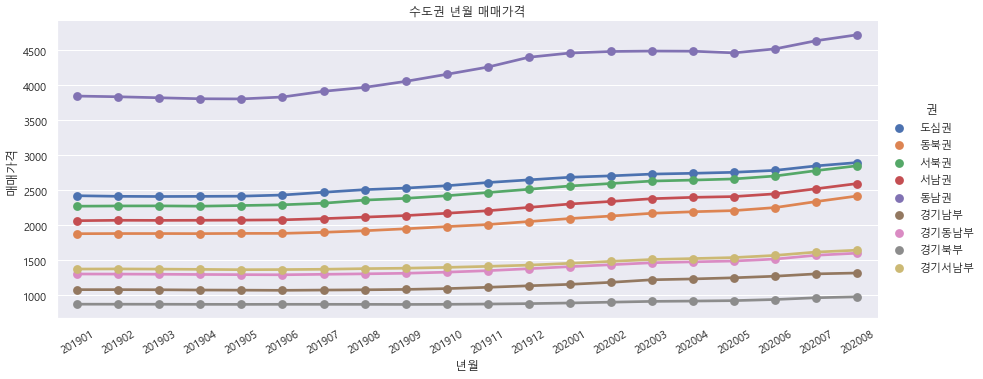

In [47]:
sns.factorplot(x='년월',y='매매가격',hue='권',aspect=2.5,data=a2_1,ci=None)
plt.xticks(rotation=30)
plt.title('수도권 년월 매매가격')
plt.show()

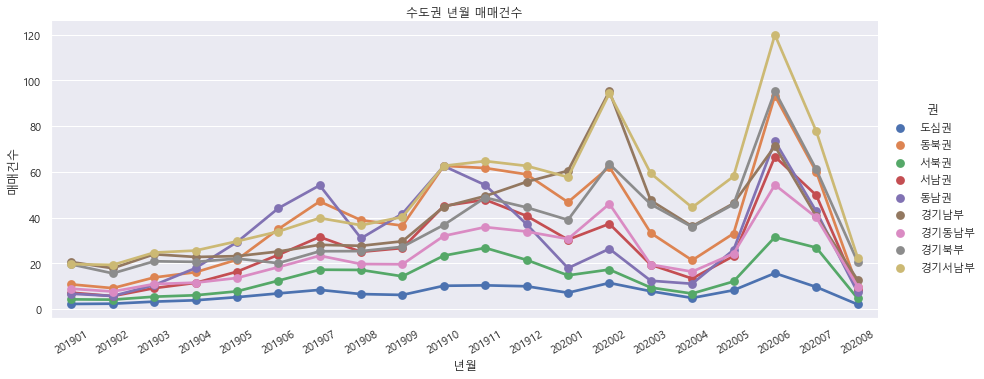

In [48]:
sns.factorplot(x='년월',y='매매건수',hue='권',aspect=2.5,data=a3,ci=None)
plt.xticks(rotation=30)
plt.title( '수도권 년월 매매건수')
plt.show()

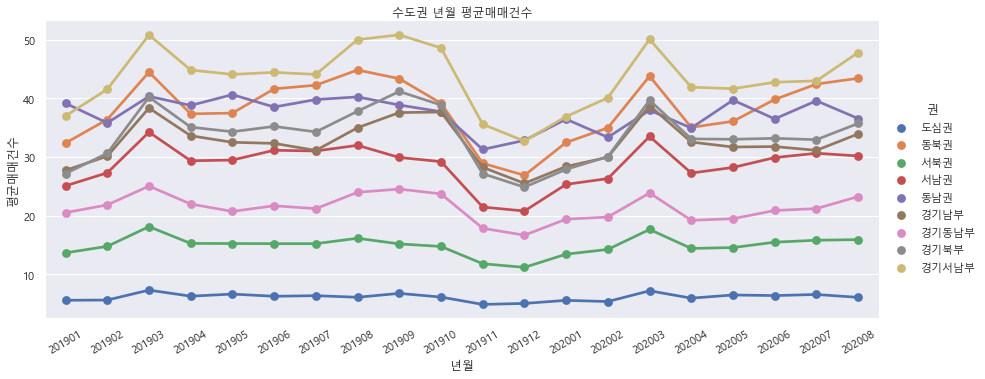

In [49]:
sns.factorplot(x='년월',y='평균매매건수',hue='권',aspect=2.5,data=a3,ci=None)
plt.xticks(rotation=30)
plt.title('수도권 년월 평균매매건수')
plt.show()

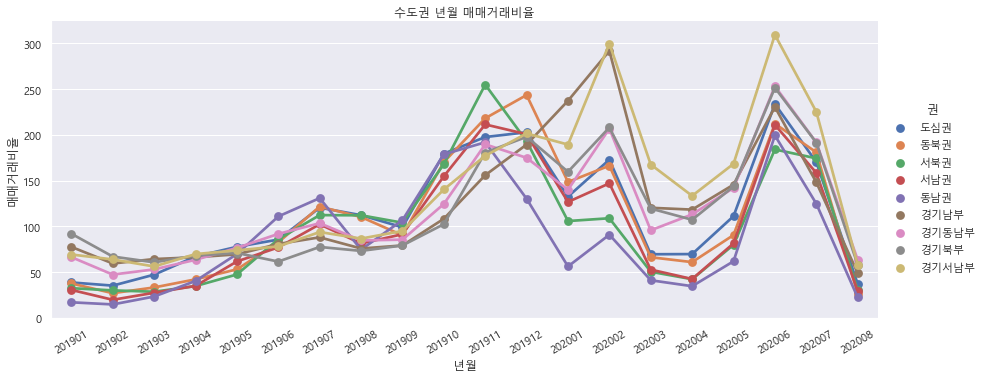

In [50]:
sns.factorplot(x='년월',y='매매거래비율',hue='권',aspect=2.5,data=a3,ci=None)
plt.xticks(rotation=30)
plt.title('수도권 년월 매매거래비율')
plt.show()

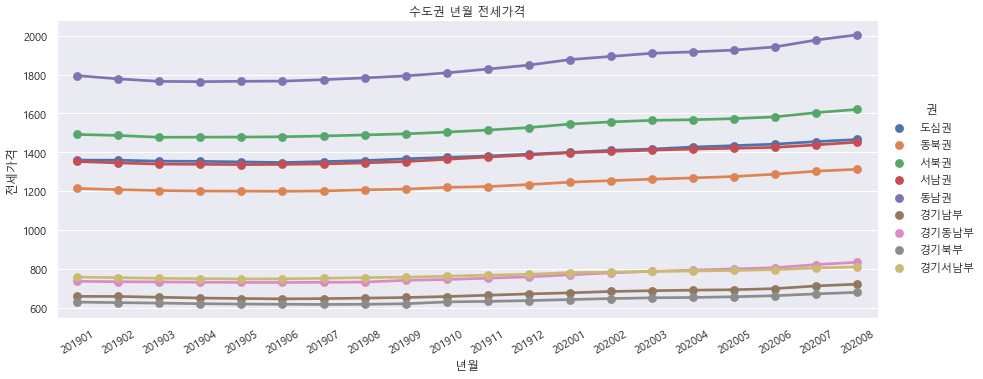

In [51]:
sns.factorplot(x='년월',y='전세가격',hue='권',aspect=2.5,data=a3,ci=None)
plt.xticks(rotation=30)
plt.title('수도권 년월 전세가격')
plt.show()

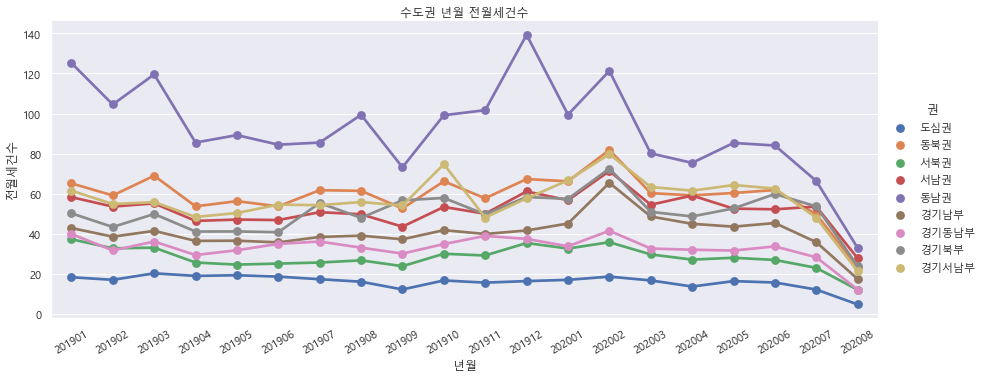

In [52]:
sns.factorplot(x='년월',y='전월세건수',hue='권',aspect=2.5,data=a3,ci=None)
plt.xticks(rotation=30)
plt.title('수도권 년월 전월세건수')
plt.show()

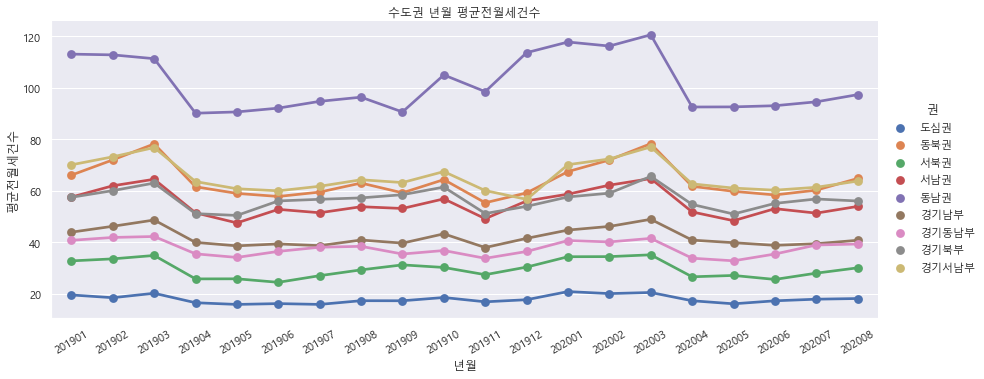

In [53]:
sns.factorplot(x='년월',y='평균전월세건수',hue='권',aspect=2.5,data=a3,ci=None)
plt.xticks(rotation=30)
plt.title('수도권 년월 평균전월세건수')
plt.show()

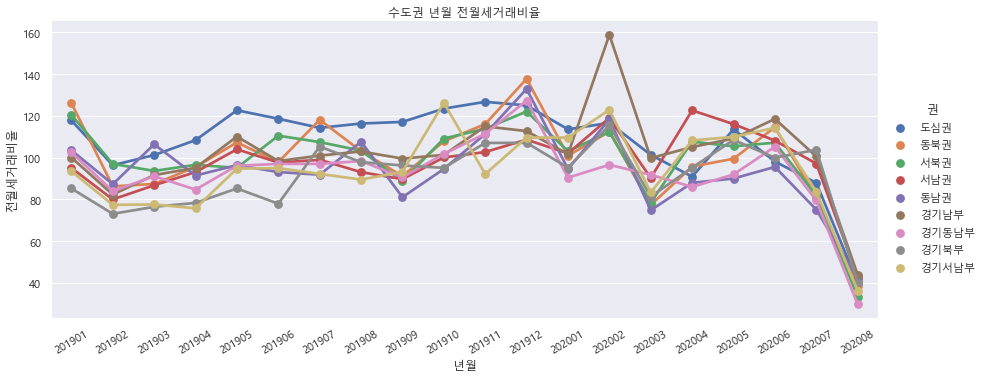

In [54]:
sns.factorplot(x='년월',y='전월세거래비율',hue='권',aspect=2.5,data=a3,ci=None)
plt.xticks(rotation=30)
plt.title('수도권 년월 전월세거래비율')
plt.show()

In [55]:
mylist=['매매가격','매매건수','매매거래비율','평균매매건수','전세가격','전월세건수','평균전월세건수','전월세거래비율']
for i in mylist:
    a3[i+'scale']=(a3[i]-a3[i].min())/(a3[i].max()-a3[i].min())+0.1

In [56]:
a3_mpt=pd.pivot_table(a3 , index=('년월','시군구명') , values=('위도','경도','매매가격','매매건수','매매거래비율','평균매매건수','전세가격','전월세건수','평균전월세건수','전월세거래비율',
                                                        '매매가격scale','매매건수scale','매매거래비율scale','평균매매건수scale','전세가격scale','전월세건수scale','평균전월세건수scale','전월세거래비율scale'))

In [57]:
a3_201902=a3_mpt.loc[201902]
a3_202002=a3_mpt.loc[202002]

In [58]:
label1=[]
for i in a3_201902.index:
    temp = i +' 매매가격 : '+ str(a3_201902.loc[i,'매매가격'])
    label1.append(temp)
label2=[]
for i in a3_202002.index:
    temp = i +' 매매가격 : '+ str(a3_202002.loc[i,'매매가격'])
    label2.append(temp)
label1
center = [37.541, 126.986]
m = folium.plugins.DualMap(location=center, zoom_start=8,zoom_control=False)
folium.Choropleth( geo_data='CTGG2.geojson',data=a3_201902,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_201902.index , '매매가격scale'),
                  fill_color='OrRd', legend_name='매매가격 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a3_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTGG2.geojson',data=a3_202002,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_202002.index, '매매가격scale'),
                  fill_color='OrRd', legend_name='매매가격 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a3_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 수도권 비교 매매가격.html")
m

In [59]:
label1=[]
for i in a3_201902.index:
    temp = i +' 매매가격 : '+ str(a3_201902.loc[i,'매매건수'])
    label1.append(temp)
label2=[]
for i in a3_202002.index:
    temp = i +' 매매가격 : '+ str(a3_202002.loc[i,'매매건수'])
    label2.append(temp)
label1
center = [37.541, 126.986]
m = folium.plugins.DualMap(location=center, zoom_start=8,zoom_control=False)
folium.Choropleth( geo_data='CTGG2.geojson',data=a3_201902,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_201902.index , '매매건수scale'),
                  fill_color='OrRd', legend_name='매매건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a3_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTGG2.geojson',data=a3_202002,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_202002.index, '매매건수scale'),
                  fill_color='OrRd', legend_name='매매건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a3_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 수도권 비교 매매건수.html")
m

In [60]:
label1=[]
for i in a3_201902.index:
    temp = i +' 평균매매건수 : '+ str(a3_201902.loc[i,'평균매매건수'])
    label1.append(temp)
label2=[]
for i in a3_202002.index:
    temp = i +' 평균매매건수 : '+ str(a3_202002.loc[i,'평균매매건수'])
    label2.append(temp)
label1
center = [37.541, 126.986]
m = folium.plugins.DualMap(location=center, zoom_start=8,zoom_control=False)
folium.Choropleth( geo_data='CTGG2.geojson',data=a3_201902,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_201902.index , '평균매매건수scale'),
                  fill_color='OrRd', legend_name='평균매매건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a3_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTGG2.geojson',data=a3_202002,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_202002.index, '평균매매건수scale'),
                  fill_color='OrRd', legend_name='평균매매건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a3_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 수도권 비교 평균매매건수.html")
m

In [61]:
label1=[]
for i in a3_201902.index:
    temp = i +' 매매거래비율 : '+ str(a3_201902.loc[i,'매매거래비율'])
    label1.append(temp)
label2=[]
for i in a3_202002.index:
    temp = i +' 매매거래비율 : '+ str(a3_202002.loc[i,'매매거래비율'])
    label2.append(temp)
label1
center = [37.541, 126.986]
m = folium.plugins.DualMap(location=center, zoom_start=8,zoom_control=False)
folium.Choropleth( geo_data='CTGG2.geojson',data=a3_201902,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_201902.index , '매매거래비율scale'),
                  fill_color='OrRd', legend_name='매매거래비율 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a3_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTGG2.geojson',data=a3_202002,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_202002.index, '매매거래비율scale'),
                  fill_color='OrRd', legend_name='매매거래비율 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a3_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 수도권 비교 매매거래비율.html")
m

In [62]:
label1=[]
for i in a3_201902.index:
    temp = i +' 전세가격 : '+ str(a3_201902.loc[i,'전세가격'])
    label1.append(temp)
label2=[]
for i in a3_202002.index:
    temp = i +' 전세가격 : '+ str(a3_202002.loc[i,'전세가격'])
    label2.append(temp)
label1
center = [37.541, 126.986]
m = folium.plugins.DualMap(location=center, zoom_start=8,zoom_control=False)
folium.Choropleth( geo_data='CTGG2.geojson',data=a3_201902,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_201902.index , '전세가격scale'),
                  fill_color='OrRd', legend_name='전세가격 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a3_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTGG2.geojson',data=a3_202002,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_202002.index, '전세가격scale'),
                  fill_color='OrRd', legend_name='전세가격 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a3_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 수도권 비교 전세가격.html")
m

In [63]:
label1=[]
for i in a3_201902.index:
    temp = i +' 전월세건수 : '+ str(a3_201902.loc[i,'전월세건수'])
    label1.append(temp)
label2=[]
for i in a3_202002.index:
    temp = i +' 전월세건수 : '+ str(a3_202002.loc[i,'전월세건수'])
    label2.append(temp)
label1
center = [37.541, 126.986]
m = folium.plugins.DualMap(location=center, zoom_start=8,zoom_control=False)
folium.Choropleth( geo_data='CTGG2.geojson',data=a3_201902,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_201902.index , '전월세건수scale'),
                  fill_color='OrRd', legend_name='전월세건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a3_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTGG2.geojson',data=a3_202002,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_202002.index, '전월세건수scale'),
                  fill_color='OrRd', legend_name='전월세건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a3_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 수도권 비교 전월세건수.html")
m

In [64]:
label1=[]
for i in a3_201902.index:
    temp = i +' 평균전월세건수 : '+ str(a3_201902.loc[i,'평균전월세건수'])
    label1.append(temp)
label2=[]
for i in a3_202002.index:
    temp = i +' 평균전월세건수 : '+ str(a3_202002.loc[i,'평균전월세건수'])
    label2.append(temp)
label1
center = [37.541, 126.986]
m = folium.plugins.DualMap(location=center, zoom_start=8,zoom_control=False)
folium.Choropleth( geo_data='CTGG2.geojson',data=a3_201902,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_201902.index , '평균전월세건수scale'),
                  fill_color='OrRd', legend_name='평균전월세건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a3_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTGG2.geojson',data=a3_202002,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_202002.index, '평균전월세건수scale'),
                  fill_color='OrRd', legend_name='평균전월세건수 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a3_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 수도권 비교 평균전월세건수.html")
m

In [65]:
label1=[]
for i in a3_201902.index:
    temp = i +' 전월세거래비율 : '+ str(a3_201902.loc[i,'전월세거래비율'])
    label1.append(temp)
label2=[]
for i in a3_202002.index:
    temp = i +' 전월세거래비율 : '+ str(a3_202002.loc[i,'전월세거래비율'])
    label2.append(temp)
label1
center = [37.541, 126.986]
m = folium.plugins.DualMap(location=center, zoom_start=8,zoom_control=False)
folium.Choropleth( geo_data='CTGG2.geojson',data=a3_201902,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_201902.index , '전월세거래비율scale'),
                  fill_color='OrRd', legend_name='전월세거래비율 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m1)

plugins.MarkerCluster(a3_201902[['위도','경도']].values,
                      popups = label1).add_to(m.m1)

folium.Choropleth( geo_data='CTGG2.geojson',data=a3_202002,
                  key_on='feature.properties.SIG_KOR_NM',columns=(a3_202002.index, '전월세거래비율scale'),
                  fill_color='OrRd', legend_name='전월세거래비율 : %',line_opacity=0.5,fill_opacity=0.7,bins=[0,0.2,0.4,0.6,0.8,1]).add_to(m.m2)

plugins.MarkerCluster(a3_202002[['위도','경도']].values,
                      popups = label2).add_to(m.m2)

m.save("./html/2019&2020 2월 수도권 비교 전월세거래비율.html")
m

In [66]:
a3_pt=pd.pivot_table(a3 , index=('년월','시군구명') , values=('위도','경도','매매가격scale'))
nl=[]
for i in a3['년월'].unique():
    temp=a3_pt.loc[i][['위도','경도','매매가격scale']].values.tolist()
    nl.append(temp)
center = [37.541, 126.986]
m = folium.Map(location=center, zoom_start=9)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.05,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/수도권 년월별 매매가격 변화.html")
m

In [67]:
a3_pt=pd.pivot_table(a3 , index=('년월','시군구명') , values=('위도','경도','매매건수scale'))
nl=[]
for i in a3['년월'].unique():
    temp=a3_pt.loc[i][['위도','경도','매매건수scale']].values.tolist()
    nl.append(temp)
center = [37.541, 126.986]
m = folium.Map(location=center, zoom_start=9)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.05,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/수도권 년월별 매매건수 변화.html")
m

In [68]:
a3_pt=pd.pivot_table(a3 , index=('년월','시군구명') , values=('위도','경도','평균매매건수scale'))
nl=[]
for i in a3['년월'].unique():
    temp=a3_pt.loc[i][['위도','경도','평균매매건수scale']].values.tolist()
    nl.append(temp)
center = [37.541, 126.986]
m = folium.Map(location=center, zoom_start=9)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.05,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/수도권 년월별 평균매매건수 변화.html")
m

In [69]:
a3_pt=pd.pivot_table(a3 , index=('년월','시군구명') , values=('위도','경도','매매거래비율scale'))
nl=[]
for i in a3['년월'].unique():
    temp=a3_pt.loc[i][['위도','경도','매매거래비율scale']].values.tolist()
    nl.append(temp)
center = [37.541, 126.986]
m = folium.Map(location=center, zoom_start=9)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.05,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/수도권 년월별 매매거래비율 변화.html")
m

In [70]:
a3_pt=pd.pivot_table(a3 , index=('년월','시군구명') , values=('위도','경도','전세가격scale'))
nl=[]
for i in a3['년월'].unique():
    temp=a3_pt.loc[i][['위도','경도','전세가격scale']].values.tolist()
    nl.append(temp)
center = [37.541, 126.986]
m = folium.Map(location=center, zoom_start=9)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.05,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/수도권 년월별 전세가격 변화.html")
m

In [71]:
a3_pt=pd.pivot_table(a3 , index=('년월','시군구명') , values=('위도','경도','전월세건수scale'))
nl=[]
for i in a3['년월'].unique():
    temp=a3_pt.loc[i][['위도','경도','전월세건수scale']].values.tolist()
    nl.append(temp)
center = [37.541, 126.986]
m = folium.Map(location=center, zoom_start=9)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.05,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/수도권 년월별 전월세건수 변화.html")
m

In [72]:
a3_pt=pd.pivot_table(a3 , index=('년월','시군구명') , values=('위도','경도','평균전월세건수scale'))
nl=[]
for i in a3['년월'].unique():
    temp=a3_pt.loc[i][['위도','경도','평균전월세건수scale']].values.tolist()
    nl.append(temp)
center = [37.541, 126.986]
m = folium.Map(location=center, zoom_start=9)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.05,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/수도권 년월별 평균전월세건수 변화.html")
m

In [73]:
a3_pt=pd.pivot_table(a3 , index=('년월','시군구명') , values=('위도','경도','전월세거래비율scale'))
nl=[]
for i in a3['년월'].unique():
    temp=a3_pt.loc[i][['위도','경도','전월세거래비율scale']].values.tolist()
    nl.append(temp)
center = [37.541, 126.986]
m = folium.Map(location=center, zoom_start=9)
hm = plugins.HeatMapWithTime(nl,index=a1['년월'].unique().tolist(), radius = 0.05,min_speed=8,max_speed=24,scale_radius=True)
hm.add_to(m)
m.save("./html/수도권 년월별 전월세거래비율 변화.html")
m